# Exploratory data analysis

## Summary
- The dataset consists of approximately 11k images. The images vary in size and orientation (vertical/horizontal), with a small portion of the images being black and white.

- Given that it's an ad dataset, the nature of the images is diverse. Some are real photos, almost unedited, while others are posters, mostly containing text. Others are illustrations. This diversity can make working with this dataset quite complicated, as most ML models are primarily suited for real-world pictures.

- In the end, an attempt was made to cluster the images. A pretrained CLIP model was used for this purpose, and the clustering was performed using the HDBSCAN algorithm. Although the result requires further fine-tuning and is not suitable for production use, even the initial attempt yielded some meaningful clusters, confirming that CLIP can be effectively used with this dataset.

## Load data

In [ ]:
! ../load_data.sh

## Imports

In [ ]:
!pip install -r notebook_requirements.txt

In [1]:
%matplotlib inline 

import os
import random

import clip
import hdbscan
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
import torch
from PIL import Image
from sklearn.manifold import TSNE
from sklearn.preprocessing import normalize
from torch.utils.data import DataLoader, Dataset
from tqdm import tqdm

## Basic stats

In [3]:
files0 = os.listdir("../data/images/0")
files1 = os.listdir("../data/images/1")

In [4]:
print("# of images")
print("Subfolder 0:", len(files0))
print("Subfolder 1:", len(files1))
print("Total:", len(files0) + len(files1))

# of images
Subfolder 0: 5673
Subfolder 1: 5433
Total: 11106


In [5]:
extensions0 = [file.split(".")[-1] for file in files0]
pd.Series(extensions0).value_counts()

jpg    5673
dtype: int64

In [6]:
extensions1 = [file.split(".")[-1] for file in files1]
pd.Series(extensions1).value_counts()

jpg    5433
dtype: int64

In [7]:
# I didn't see any significant difference between images from the two subfolders,
# so I'm merging them from now on
all_paths = (
    [os.path.join("../data/images/0", file) for file in files0 if file.endswith('jpg')]
    + [os.path.join("../data/images/1", file) for file in files1 if file.endswith('jpg')]
)

## Sample images

In [8]:
def sample_random_images(files, num_samples=5):
    sampled_images = random.sample(files, num_samples)
    
    _, axs = plt.subplots(1, num_samples, figsize=(20, 10), tight_layout=True)
    
    for ax, image_path in zip(axs, sampled_images):
        img = mpimg.imread(image_path)
        ax.imshow(img)
        ax.axis('off')
        ax.set_title(image_path)
    plt.show()

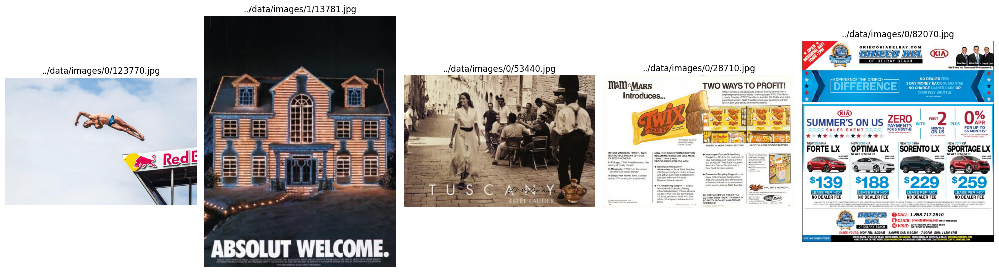

In [9]:
sample_random_images(all_paths, num_samples=5)

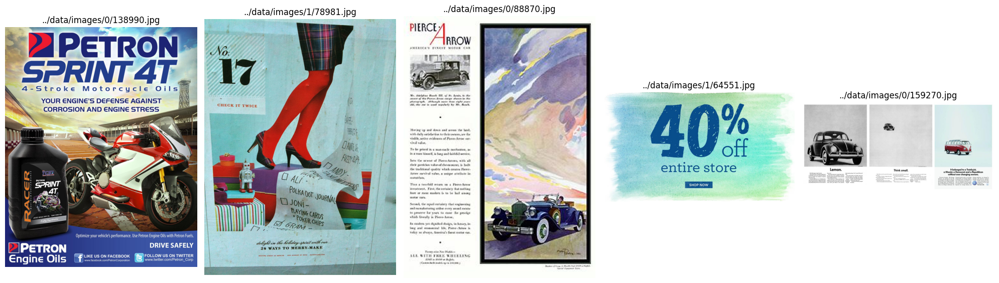

In [10]:
sample_random_images(all_paths, num_samples=5)

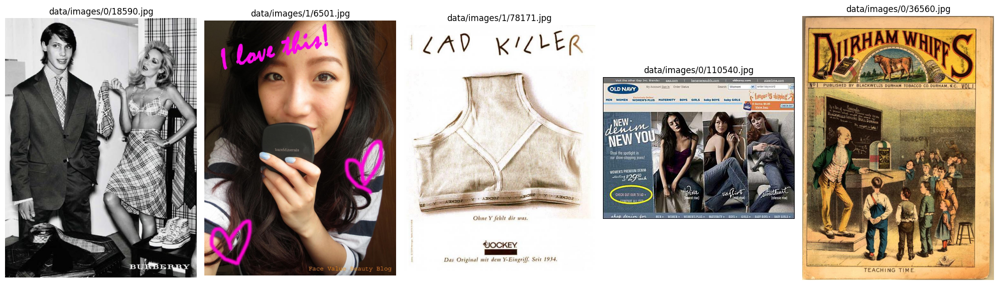

In [29]:
sample_random_images(all_paths, num_samples=5)

## Resolution analysis

In [11]:
widths, heights, n_channels = [], [], []

for file in tqdm(all_paths):
    img = mpimg.imread(file)
    if len(img.shape) == 3:
        width, height, channels = img.shape
        n_channels.append(channels)
    elif len(img.shape) == 2:
        width, height = img.shape
        n_channels.append(1)
    else:
        raise Exception(img.shape)
    widths.append(width)
    heights.append(height)

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 11106/11106 [01:05<00:00, 169.38it/s]


In [12]:
pd.Series(n_channels).value_counts()

3    11039
1       67
dtype: int64

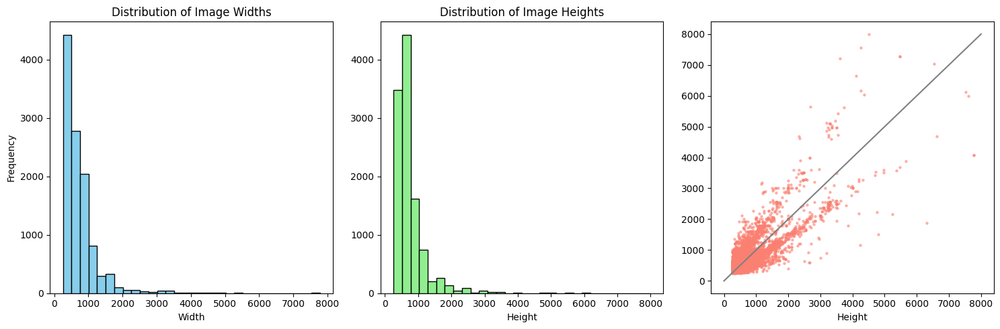

In [13]:
_, axs = plt.subplots(1, 3, figsize=(15, 5), tight_layout=True)

axs[0].hist(widths, bins=30, color='skyblue', edgecolor='black')
axs[0].set_title('Distribution of Image Widths')
axs[0].set_xlabel('Width')
axs[0].set_ylabel('Frequency')

axs[1].hist(heights, bins=30, color='lightgreen', edgecolor='black')
axs[1].set_title('Distribution of Image Heights')
axs[1].set_xlabel('Height')

axs[2].scatter(widths, heights, s=5, alpha=0.5, color='salmon')
axs[2].plot([0, 8000], [0, 8000], color='gray')
axs[2].set_xlabel('Width')
axs[2].set_xlabel('Height')

plt.show()

In [31]:
pd.Series(widths).describe().round(2)

count    11106.00
mean       735.07
std        533.36
min        256.00
25%        415.00
50%        600.00
75%        849.00
max       7780.00
dtype: float64

In [32]:
pd.Series(heights).describe().round(2)

count    11106.00
mean       743.11
std        513.58
min        256.00
25%        480.00
50%        600.00
75%        800.00
max       8000.00
dtype: float64

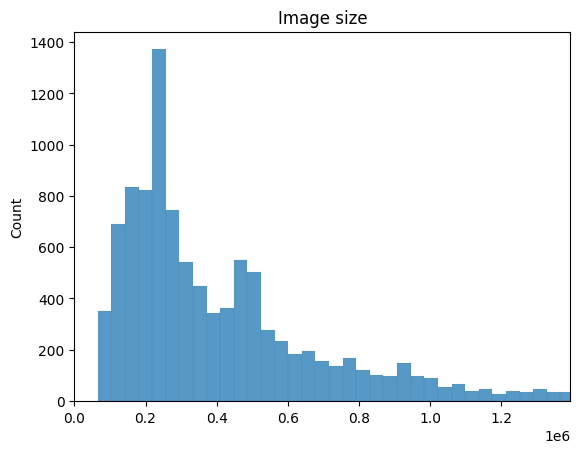

count       11106.00
mean       756802.66
std       1862207.42
min         65536.00
25%        221216.50
50%        351380.00
75%        648000.00
max      46081167.00
dtype: float64

In [40]:
sizes = [w * h for w, h in zip(widths, heights)]

sns.histplot(sizes)
plt.title("Image size")
plt.xlim(0, np.percentile(sizes, 90))
plt.show()

pd.Series(sizes).describe().round(2)

## Clustering
Embed images with CLIP and try to cluster with HDBSCAN

In [14]:
model, transform = clip.load("ViT-B/32", device="cpu")

In [15]:
transform

Compose(
    Resize(size=224, interpolation=bicubic, max_size=None, antialias=None)
    CenterCrop(size=(224, 224))
    <function _convert_image_to_rgb at 0x14573f790>
    ToTensor()
    Normalize(mean=(0.48145466, 0.4578275, 0.40821073), std=(0.26862954, 0.26130258, 0.27577711))
)

In [16]:
class ImageDataset(Dataset):
    def __init__(self, image_paths, transform):
        self.image_paths = image_paths
        self.transform = transform

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        img = Image.open(self.image_paths[idx])
        img = self.transform(img)
        return img

In [17]:
dataset = ImageDataset(
    image_paths=all_paths, 
    transform=transform,
)

dataloader = DataLoader(dataset, batch_size=512, shuffle=False)

In [18]:
embeddings = []
with torch.no_grad():
    for images in tqdm(dataloader):
        image_embs = model.encode_image(images)
        embeddings.append(image_embs.detach().cpu().numpy())
embeddings = np.concatenate(embeddings)
embeddings.shape

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [03:46<00:00, 10.30s/it]


(11106, 512)

In [19]:
normalized_embeddings = normalize(embeddings, norm='l2', axis=1)

In [20]:
projection = TSNE().fit_transform(normalized_embeddings)

/Users/e.trufanova/.pyenv/versions/3.8.6/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/e.trufanova/.pyenv/versions/3.8.6/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


In [21]:
clusterer = hdbscan.HDBSCAN(min_cluster_size=10, prediction_data=True).fit(normalized_embeddings)

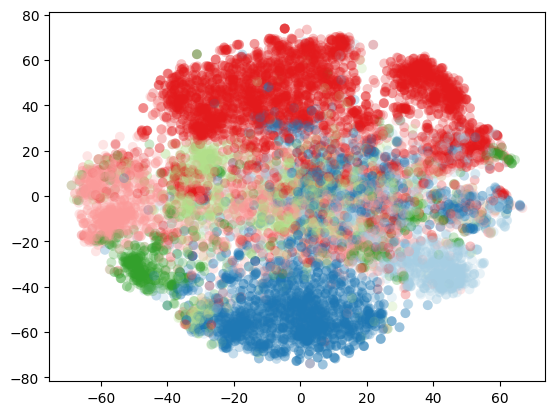

In [25]:
soft_clusters = hdbscan.all_points_membership_vectors(clusterer)
color_palette = sns.color_palette('Paired', 12)
cluster_colors = [color_palette[np.argmax(x)]
                  for x in soft_clusters]
plt.scatter(*projection.T, s=50, linewidth=0, c=cluster_colors, alpha=0.25)

In [29]:
print("Number of clusters:", clusterer.labels_.max())

clusters = soft_clusters.argmax(axis=1)
pd.Series(clusters).value_counts()

Number of clusters: 5


5    3864
1    2641
4    1717
2    1167
0    1047
3     670
dtype: int64

## Analyzing clusters

### Cluster 0
**Primarily contains electronics and Internet advertisements**

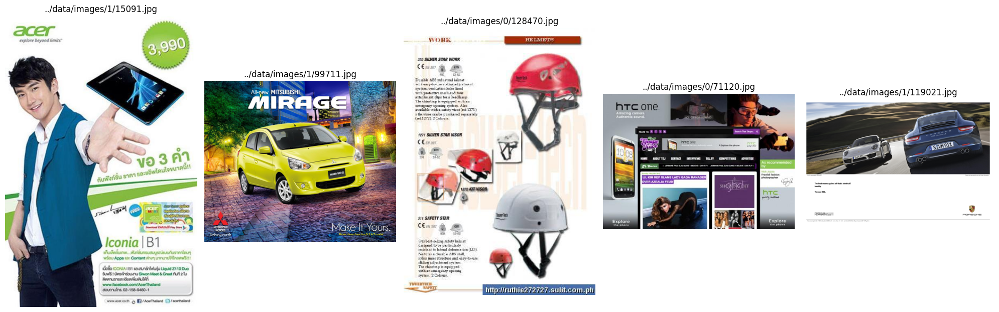

In [43]:
sample_random_images(list(np.array(all_paths)[clusters == 0]), num_samples=5)

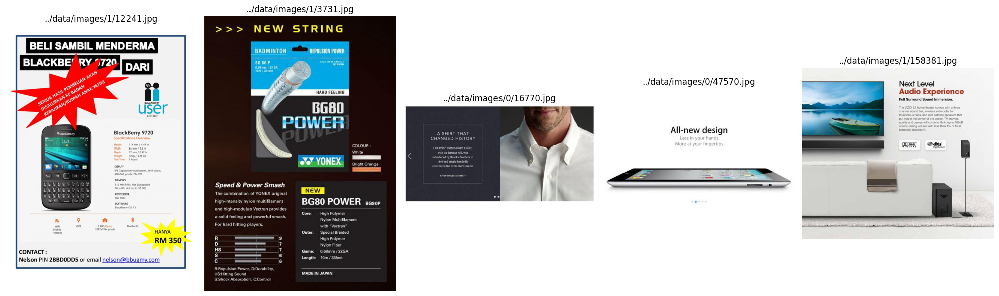

In [44]:
sample_random_images(list(np.array(all_paths)[clusters == 0]), num_samples=5)

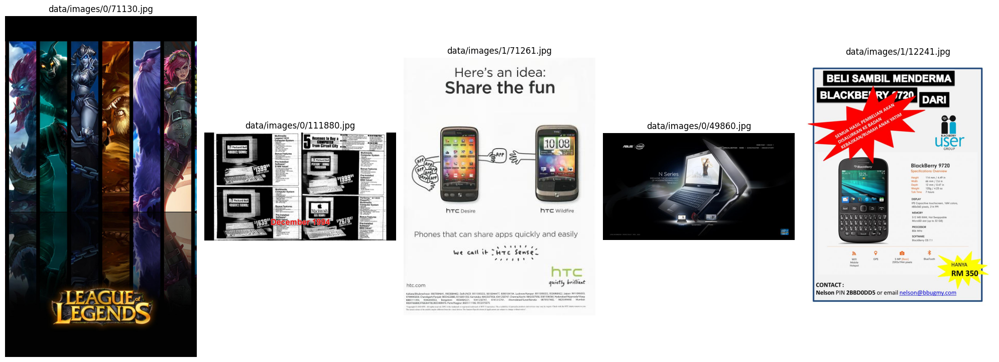

In [173]:
sample_random_images(list(np.array(all_paths)[clusters == 0]), num_samples=5)

### Cluster 1
**Most of the images depict people. The ads are mostly around fashion, perfumes and beauty products**

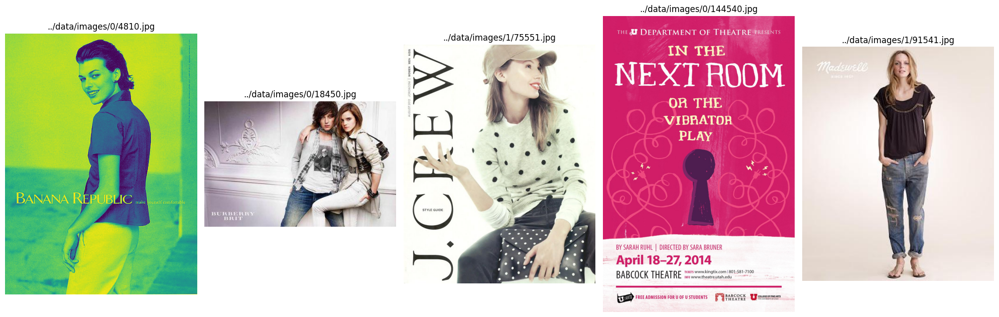

In [50]:
sample_random_images(list(np.array(all_paths)[clusters == 1]), num_samples=5)

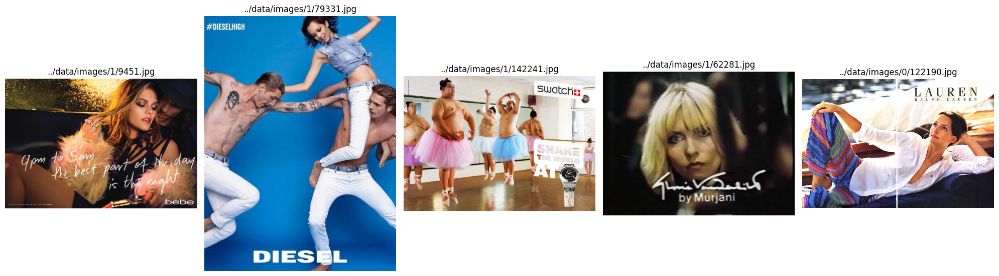

In [52]:
sample_random_images(list(np.array(all_paths)[clusters == 1]), num_samples=5)

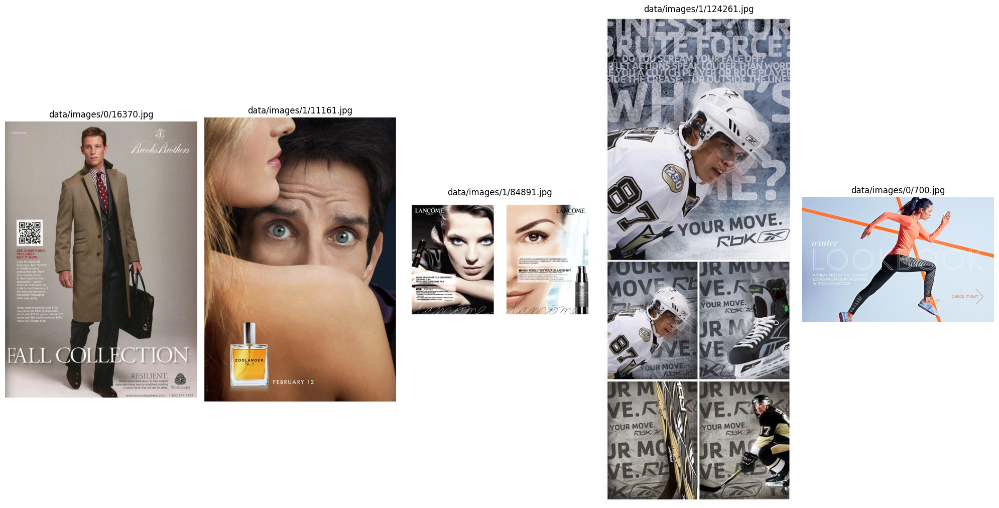

In [194]:
sample_random_images(list(np.array(all_paths)[clusters == 1]), num_samples=5)

### Cluster 2
**This one looks a bit noisy. Clearly it contains posters and non-real-world pictures. Also, a lot of drinks ads can be seen in this cluster.** 

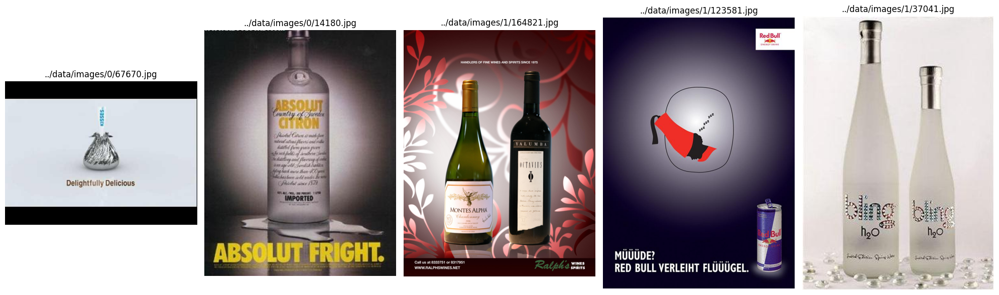

In [58]:
sample_random_images(list(np.array(all_paths)[clusters == 2]), num_samples=5)

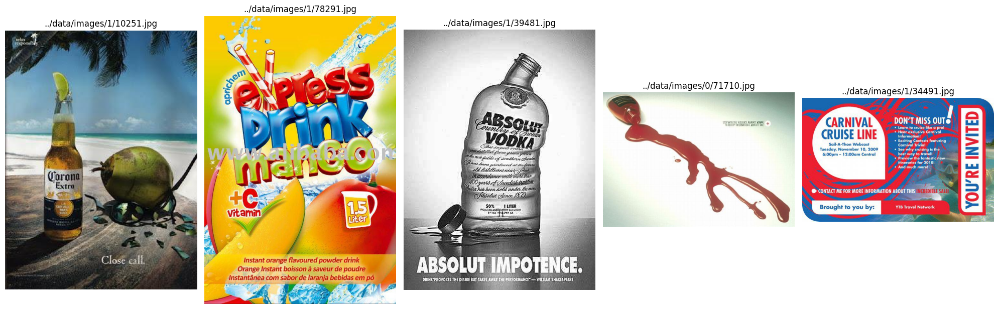

In [61]:
sample_random_images(list(np.array(all_paths)[clusters == 2]), num_samples=5)

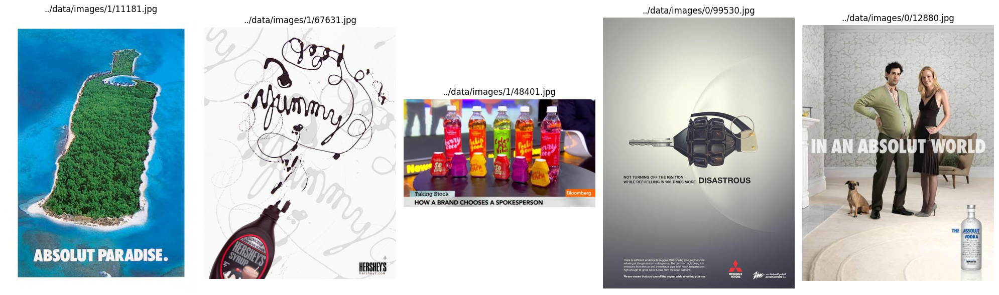

In [62]:
sample_random_images(list(np.array(all_paths)[clusters == 2]), num_samples=5)

### Cluster 3
**Contains advertising brochures and booklets with prices**

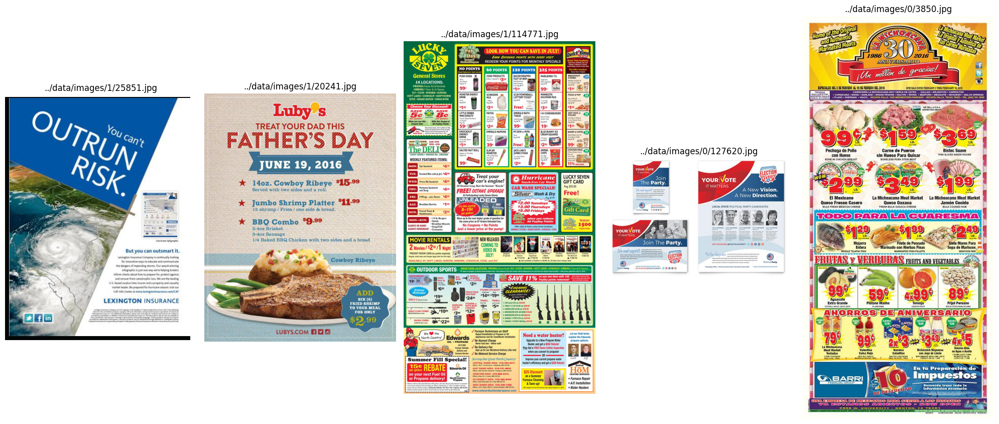

In [66]:
sample_random_images(list(np.array(all_paths)[clusters == 3]), num_samples=5)

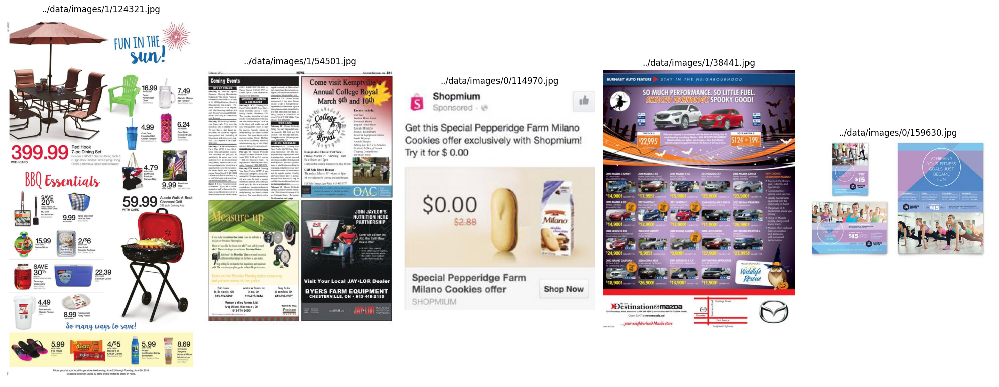

In [67]:
sample_random_images(list(np.array(all_paths)[clusters == 3]), num_samples=5)

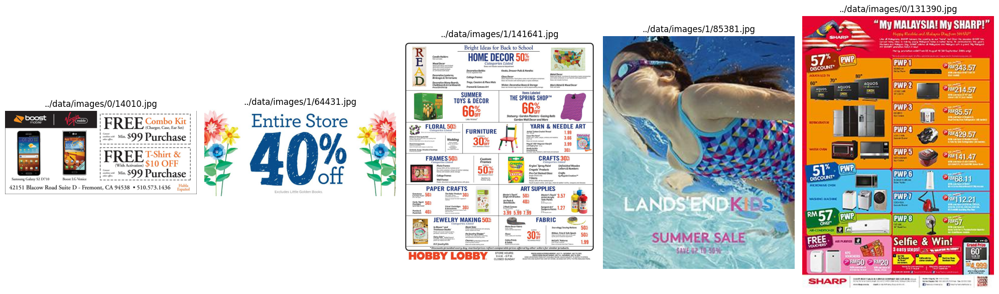

In [70]:
sample_random_images(list(np.array(all_paths)[clusters == 3]), num_samples=5)

### Cluster 4
**This cluster is clearly about food**

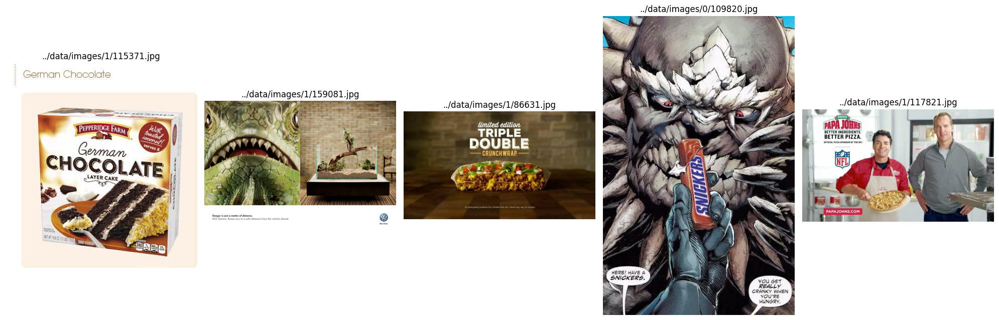

In [73]:
sample_random_images(list(np.array(all_paths)[clusters == 4]), num_samples=5)

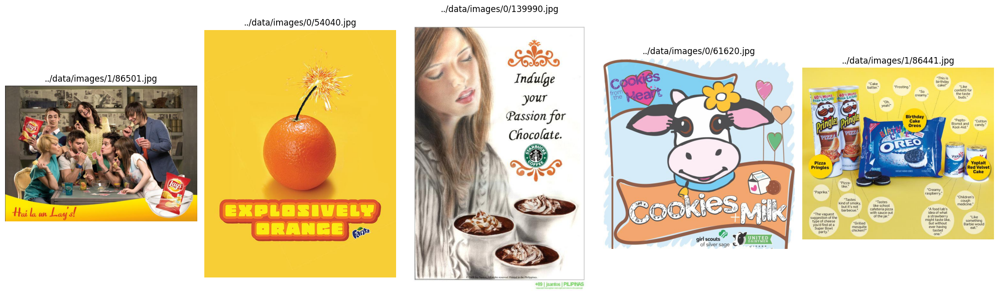

In [94]:
sample_random_images(list(np.array(all_paths)[clusters == 4]), num_samples=5)

### Cluster 5
**This cluster seems to contains old-school ad posters mostly**

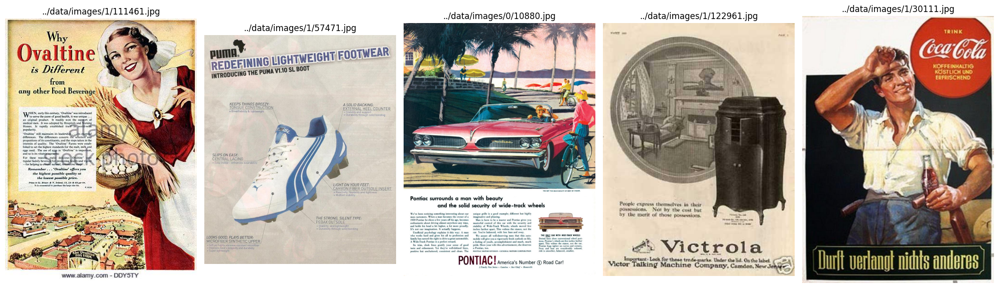

In [95]:
sample_random_images(list(np.array(all_paths)[clusters == 5]), num_samples=5)

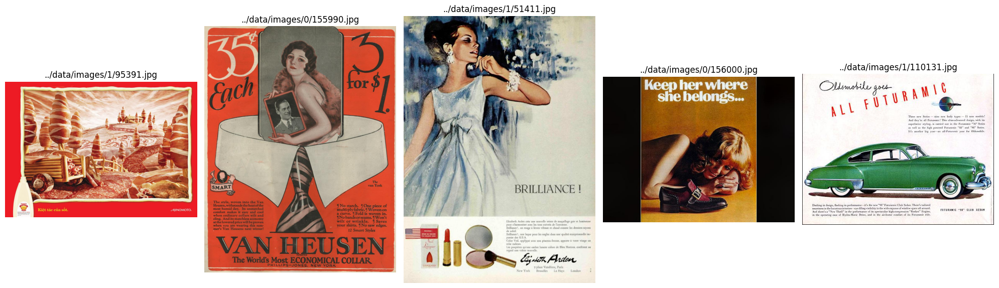

In [97]:
sample_random_images(list(np.array(all_paths)[clusters == 5]), num_samples=5)

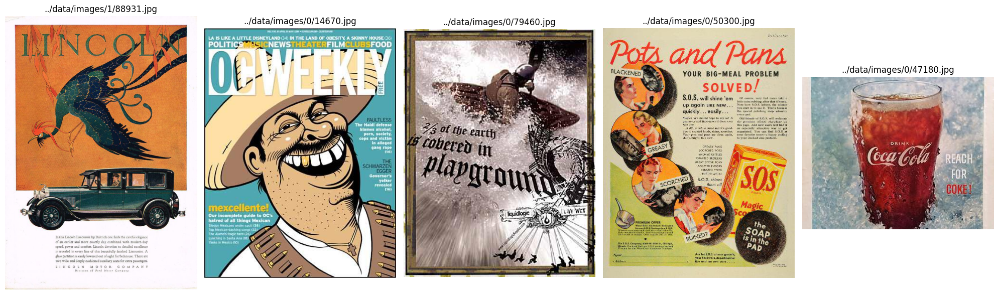

In [98]:
sample_random_images(list(np.array(all_paths)[clusters == 5]), num_samples=5)